In [6]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
import sys
import gzip
import copy
import json
import scipy.stats as stats
from collections import defaultdict
import datetime
import time
import math
from scipy.stats import gaussian_kde
import pandas as pd
import scipy.stats 
import random
import os
import cv2
import matplotlib.image as mpimg
from tqdm import tqdm
import pickle
import csv
sys.path.append('../')

import img_processing_util

img_db_path = '/data/rakhasan/bystander-detection/coco/'


In [15]:
def draw_rect_r(img, rectangles, c=(0,255,0)):
    #print(len(rectangles))
    for r in rectangles:
        xmin, xmax, ymin, ymax = r[0],r[1],r[2],r[3]
        #print( xmin, xmax, ymin, ymax)
        cv2.rectangle( img, (int(xmin), int(ymin)),
                      (int(xmax), int(ymax)), color = c, thickness = 3 )
    return img

def draw_photos_with_rectangle(photos, col_size=3):
    '''
    Draw photos after overlaying rectangles on them.
    Parameters:
        photos: dictionary with photo file paths as keys and rectangles as values.
    '''
    out = []
    for s in photos:
        img = mpimg.imread(s)
        out.append(img_processing_util.draw_rect_r(img, photos[s]))
       
    img_processing_util.draw_photos(out, col_size=col_size)

In [3]:
annotations = json.load(open(img_db_path+'/annotations/instances_train2014.json','r'))


In [4]:
#len(annotations)
annotations['info']
#annotations.keys()

{'contributor': 'COCO Consortium',
 'date_created': '2017/09/01',
 'description': 'COCO 2014 Dataset',
 'url': 'http://cocodataset.org',
 'version': '1.0',
 'year': 2014}

In [5]:
image_desc = annotations['images']
print('number of images:', len(image_desc))

number of images: 82783


In [6]:
'''Create dictionary of image info'''
image_dict=dict()
for img in image_desc:
    img_id=int(img['file_name'].split('.')[0].split('_')[-1])
    image_dict[img_id]=img

In [7]:
bboxes = annotations['annotations']
print('number of boxes:',len(bboxes))

number of boxes: 604907


In [8]:
person_boxes = [b for b in bboxes if b['category_id']==1]
print('number of person boxes:',len(person_boxes))

number of person boxes: 185316


In [10]:
image_desc[0]

{'coco_url': 'http://images.cocodataset.org/train2014/COCO_train2014_000000057870.jpg',
 'date_captured': '2013-11-14 16:28:13',
 'file_name': 'COCO_train2014_000000057870.jpg',
 'flickr_url': 'http://farm4.staticflickr.com/3153/2970773875_164f0c0b83_z.jpg',
 'height': 480,
 'id': 57870,
 'license': 5,
 'width': 640}

In [11]:
'''
Create a dictionary:
    key: image id
    value: list of bboxes, img url, and other annotation data
'''

photos_with_person = defaultdict(list)
for bb in person_boxes:
    '''dont include if the bounding box contain more than 
        one object or if the file name does not match'''
    if bb['iscrowd']==0:
        if os.path.isfile('{}/images2014/COCO_train2014_000000{}.jpg'.format(
                img_db_path,bb['image_id'])):
            photos_with_person[bb['image_id']].append(bb)

In [12]:
len(photos_with_person),sum([len(x) for x in photos_with_person.values()])

(37324, 150099)

In [13]:
photos_with_person[57684]

[]

[495987, 223214, 316583, 380447, 402249, 120737, 308701, 248878, 129436]
3 3


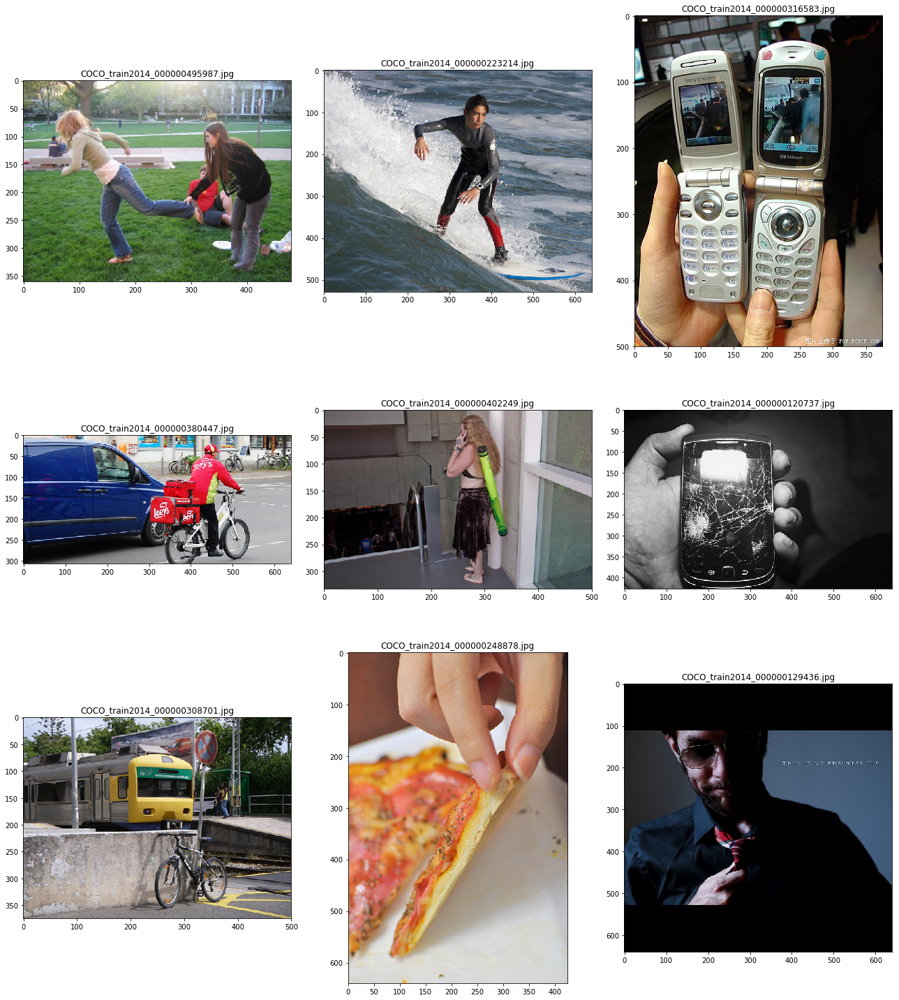

In [14]:
photos = random.sample(list(photos_with_person.keys()),9)
print(photos)
helper_dataset.draw_photos_from_path(
['{}/images2014/COCO_train2014_000000{}.jpg'.format(img_db_path,i) for i in photos],col_size=3)

In [15]:
'''
Group images by number of people.
'''
person_anno_by_num =defaultdict(lambda: defaultdict(list))
for photo_id in photos_with_person.keys():
    annotations = photos_with_person[photo_id]
    person_anno_by_num[len(annotations)][photo_id] = annotations

print(sum([len(d) for d in person_anno_by_num.values()]))
for d in sorted(person_anno_by_num.keys()):
    print(d, len(person_anno_by_num[d]))

37325
0 1
1 14298
2 6318
3 3455
4 2280
5 1626
6 1210
7 981
8 845
9 706
10 739
11 731
12 893
13 3235
14 4
15 1
17 1
19 1


In [20]:
'''Keep only images where number of people<=5'''
final_annotations = defaultdict(lambda: defaultdict(list))
for k in range(1,6):
    final_annotations[k] = person_anno_by_num[k]

NameError: name 'person_anno_by_num' is not defined

In [17]:
print('total:', sum([len(d) for d in final_annotations.values()]))    
total = 0
for d in sorted(final_annotations.keys()):
    print('{}: {}*{} = {}'.format(d, len(final_annotations[d]), d,  len(final_annotations[d])* d))
    total += len(final_annotations[d])* d
print('total:', total)

total: 27977
1: 14298*1 = 14298
2: 6318*2 = 12636
3: 3455*3 = 10365
4: 2280*4 = 9120
5: 1626*5 = 8130
total: 54549


In [19]:
final_annotations[1][130406]
#image_dict[473326]

NameError: name 'final_annotations' is not defined

In [ ]:

for i in range(1,6):
    photos = random.sample(list(final_annotations[i].keys()),16)
    print(photos)
    d=dict()
    for p in photos:
        rects=[]
        for r in final_annotations[i][p]:
            box=r['bbox']
            rects.append([box[0],box[0]+box[2],box[1],box[1]+box[3]])
        d['{}/images2014/COCO_train2014_000000{}.jpg'.format(img_db_path,p)] = rects
    draw_photos_with_rectangle(d, col_size=4)

[533770, 404221, 335594, 179805, 531855, 409165, 322891, 246456, 458135, 227689, 153067, 448616, 103730, 576993, 234748, 468009]
4 4


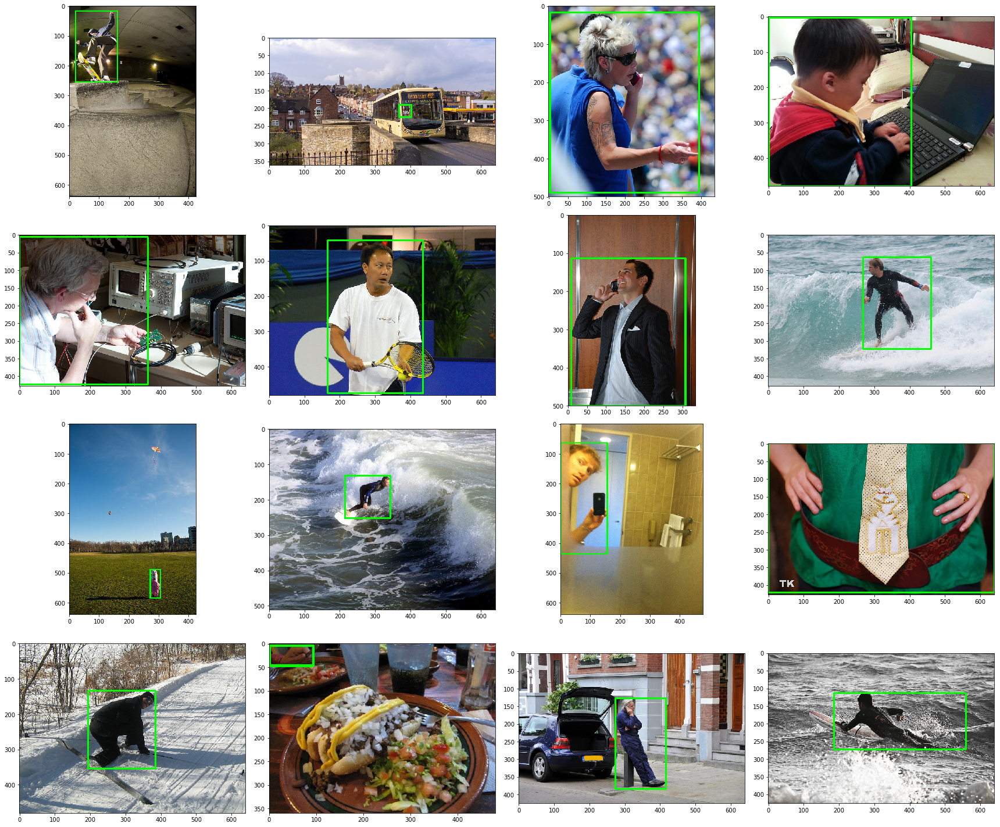

[214371, 556955, 136721, 398704, 473762, 438375, 164727, 426568, 293339, 245132, 341596, 361619, 336897, 212070, 155450, 387368]
4 4


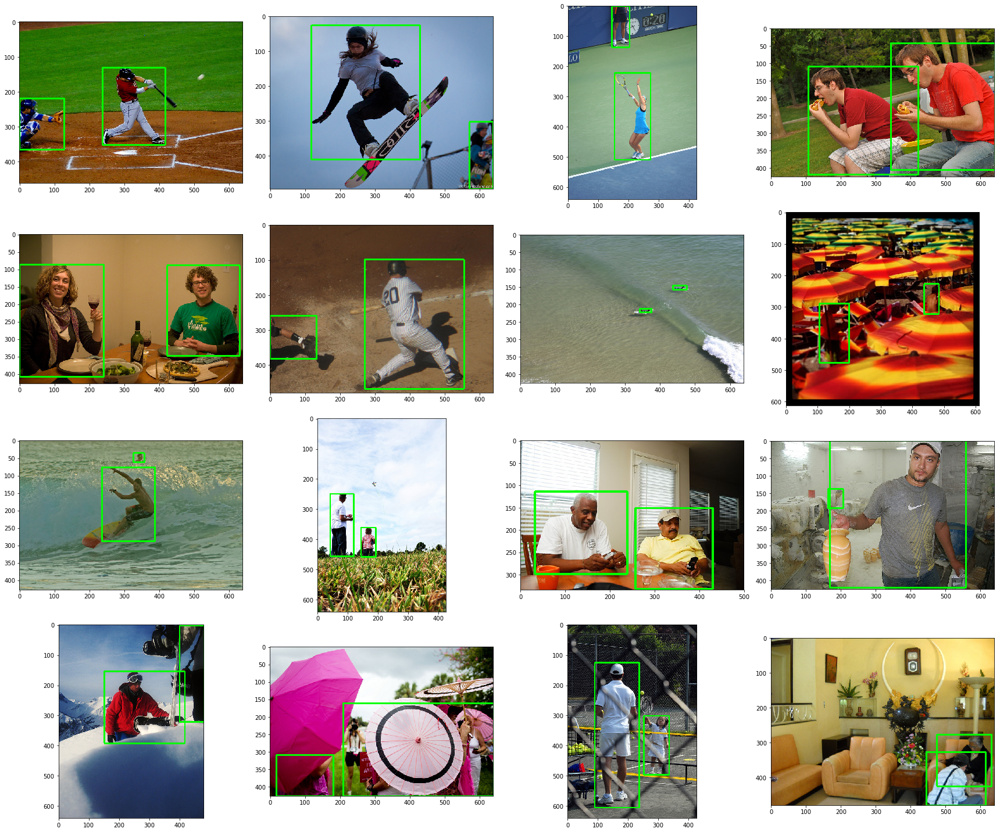

[270111, 453231, 167352, 229947, 500390, 162193, 190566, 237560, 567274, 466828, 580850, 301874, 329784, 543617, 445607, 313020]
4 4


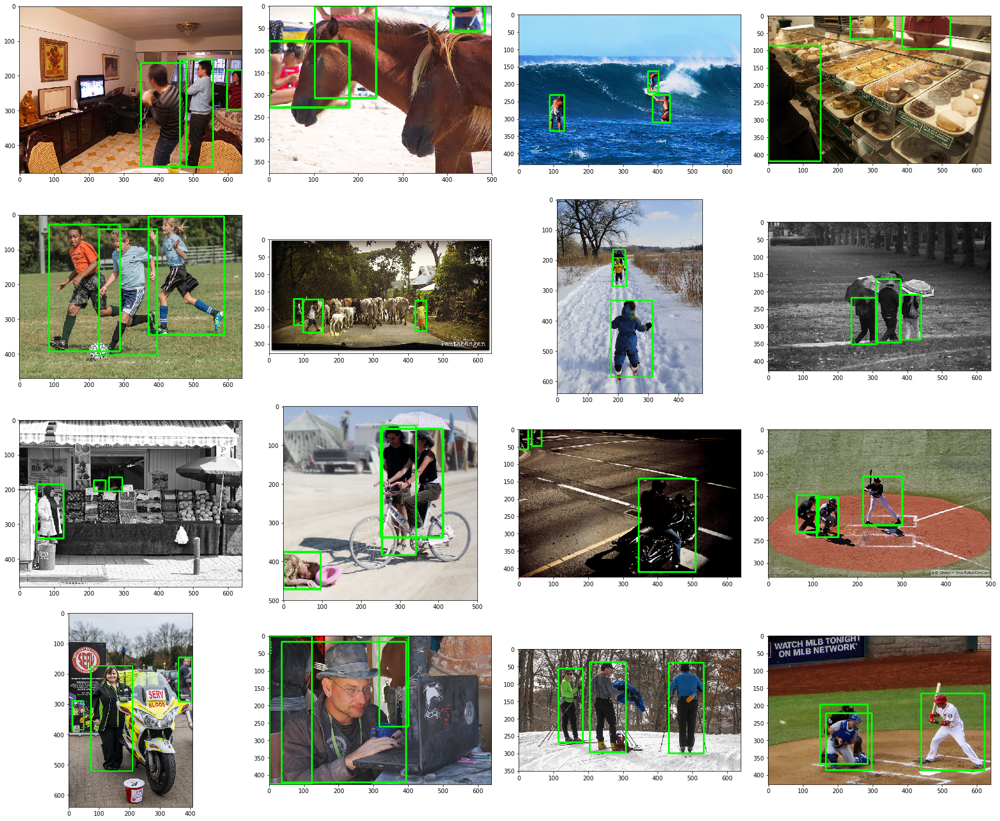

[554943, 191625, 423023, 164572, 337325, 466432, 233137, 385672, 342583, 102787, 542178, 545675, 535517, 348382, 446834, 493845]
4 4


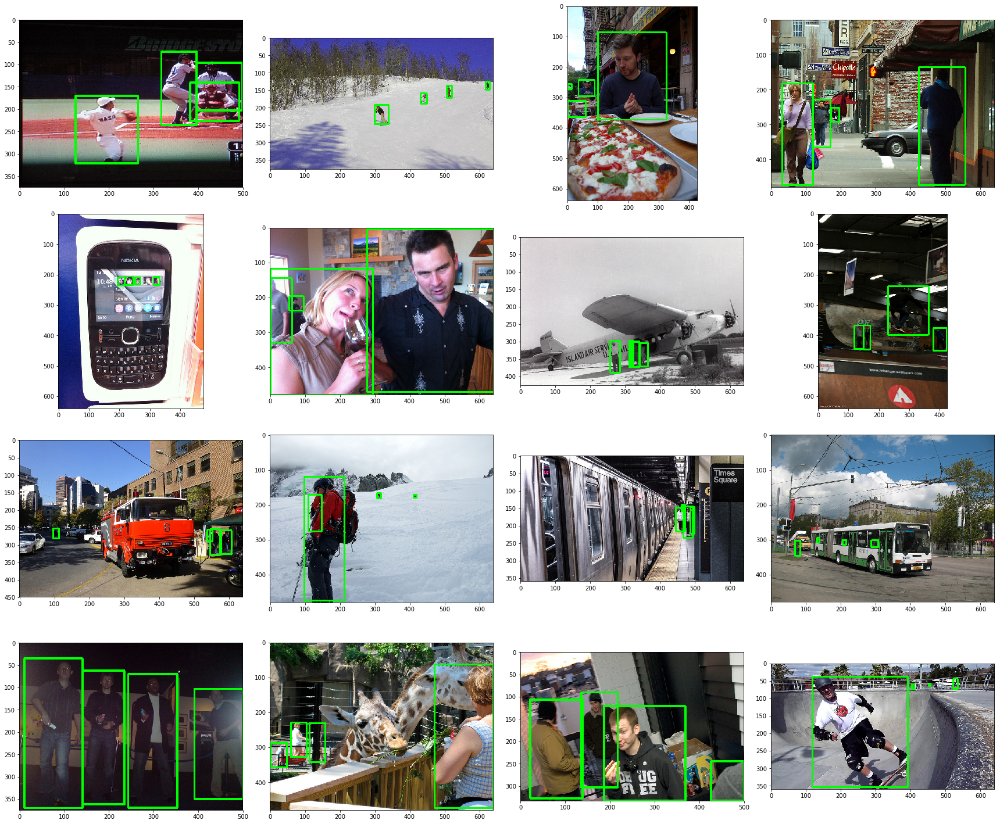

[129871, 273879, 384263, 542088, 572001, 353907, 570522, 512533, 209056, 121749, 542231, 450975, 331264, 551194, 154220, 103929]
4 4


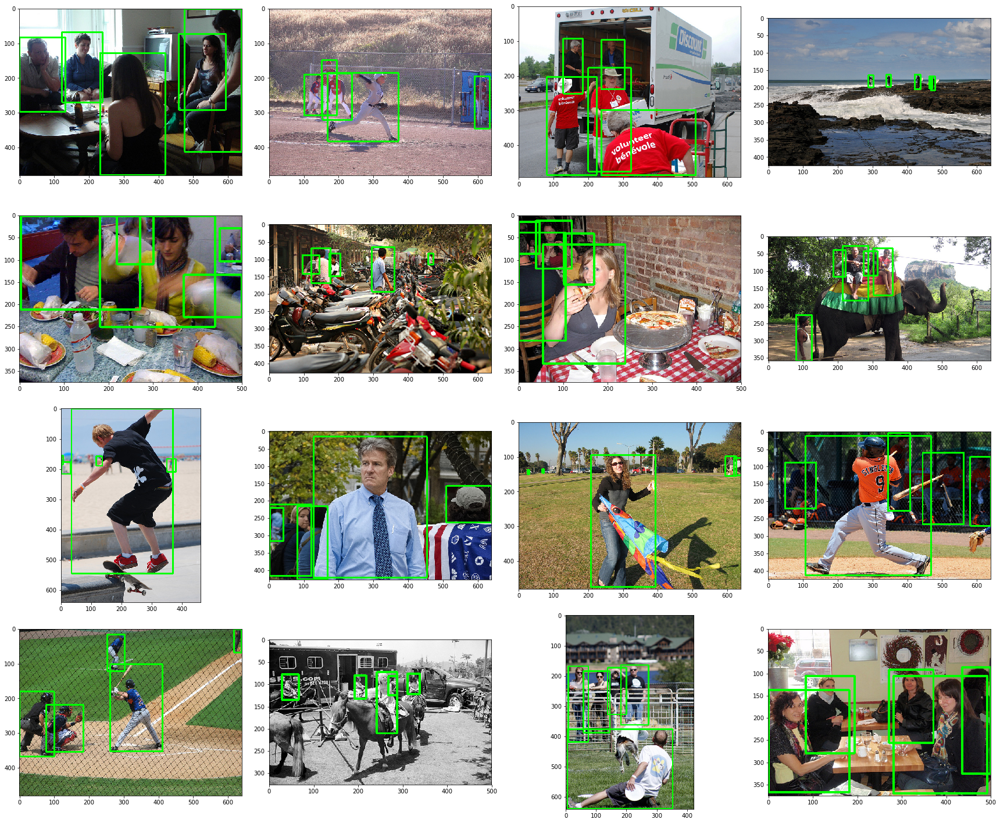

In [19]:

for i in range(1,6):
    photos = random.sample(list(final_annotations[i].keys()),16)
    print(photos)
    d=dict()
    for p in photos:
        rects=[]
        for r in final_annotations[i][p]:
            box=r['bbox']
            rects.append([box[0],box[0]+box[2],box[1],box[1]+box[3]])
        d['{}/images2014/COCO_train2014_000000{}.jpg'.format(img_db_path,p)] = rects
    draw_photos_with_rectangle(d, col_size=4)

# Create mappings for the pilots

In [9]:
pilot_path = '/data/rakhasan/bystander-detection/pilot3_coco/'

In [35]:
'''
Keep a list of images used in the survey.
Each entry in the list will contain:
    image_id: the original image id which is also the name of the image.
    annotations: bounding box information.
'''
count = 5 
'''For pilot3, take total 700'''
one_person_photos = random.sample(list(final_annotations[1].keys()), 200)
two_person_photos = random.sample(list(final_annotations[2].keys()), 100)
three_person_photos = random.sample(list(final_annotations[3].keys()), 67)
four_person_photos = random.sample(list(final_annotations[4].keys()), 50)
five_person_photos = random.sample(list(final_annotations[5].keys()), 40)

one_person_annotations = [final_annotations[1][k][0] for k in one_person_photos]
two_person_annotations = []
for k in two_person_photos:
    for a in final_annotations[2][k]:
        two_person_annotations.append(a)
three_person_annotations = []
for k in three_person_photos:
    for a in final_annotations[3][k]:
        three_person_annotations.append(a)
four_person_annotations = []
for k in four_person_photos:
    for a in final_annotations[4][k]:
        four_person_annotations.append(a)
five_person_annotations = []
for k in five_person_photos:
    for a in final_annotations[5][k]:
        five_person_annotations.append(a)

In [ ]:
'''Rearrange the annotation lists so that in a list adjacent photos(persons) are different'''
#from itertools import *
import itertools

two_person_annotations_seq = list(itertools.chain.from_iterable([two_person_annotations[i::2] for i in range(2)]))
three_person_annotations_seq = list(itertools.chain.from_iterable([three_person_annotations[i::3] for i in range(3)]))
four_person_annotations_seq = list(itertools.chain.from_iterable([four_person_annotations[i::4] for i in range(4)]))
five_person_annotations_seq = list(itertools.chain.from_iterable([five_person_annotations[i::5] for i in range(5)]))

In [40]:
'''Concate the lists of annotations. The index of the annotations will be used as mapped filename'''
mapping = []
for i in range(0, 200):
    mapping.append(one_person_annotations[i])
    mapping.append(two_person_annotations_seq[i])
    mapping.append(three_person_annotations_seq[i])
    mapping.append(four_person_annotations_seq[i])
    mapping.append(five_person_annotations_seq[i])


In [29]:
mapping = pickle.load(open(os.path.join(pilot_path, 'mappings-coco.pkl'), 'rb'))
mapping = pickle.load(open(os.path.join(pilot_path, 'mappings_common.pkl'), 'rb'))
#pickle.dump(mapping,open(pilot_path+'/mappings-coco.pkl', 'wb'))

In [30]:
mapping[0]

{'bbox': [327.28, 349.90999999999997, 185.88, 252.58999999999997],
 'fileName': 'COCO_train2014_000000526881.jpg',
 'imageId': 526881,
 'index': 0}

In [32]:
photos = random.sample(mapping,9)
print([p['imageId'] for p in photos])
d=dict()
for photo in photos:
    r=photo['bbox']
    rects=[[r[0],r[0]+r[2],r[1],r[1]+r[3]]]
    d['{}/images2014/{}.jpg'.format(img_db_path,photo['fileName'])] = rects
draw_photos_with_rectangle(d, col_size=3)

[340331, 243526, 497498, 525589, 251663, 477858, 557567, 330572, 545721]


FileNotFoundError: [Errno 2] No such file or directory: '/data/rakhasan/bystander-detection/coco//images2014/COCO_train2014_000000340331.jpg.jpg'

In [44]:
'''Generate photos with single rectangles to show study participants'''
from scipy import ndimage

def add_bb_to_photo(output_dir, mapping):
    #output_dir = '/data/rakhasan/bystander-detection/pilot-study/photos/'
    for i in tqdm(range(len(mapping))):
        m = mapping[i]
        photo_file = '{}/images2014/COCO_train2014_000000{}.jpg'.format(img_db_path,m['image_id'])
        img = cv2.imread(photo_file)
        bb=m['bbox']
        outimg = draw_rect_r(img=img, rectangles=[[bb[0],bb[0]+bb[2], bb[1],bb[1]+bb[3]]])
        cv2.imwrite(os.path.join(output_dir, str(i) + '.jpg'),outimg)


In [45]:
'''Add BB in the photos'''
#add_bb_to_photo(mapping=mapping, output_dir=pilot_path+'/photos/')

100%|██████████| 1000/1000 [00:30<00:00, 32.46it/s]


In [86]:
'''Create cropped images'''
in_dir = '/data/rakhasan/bystander-detection/pilot3_coco/photos/'
out_dir = '/data/rakhasan/bystander-detection/pilot3_coco/cropped-photos/'

# for i in tqdm(range(len(mapping))):
#         m = mapping[i]
#         photo_file = '{}/{}.jpg'.format(in_dir,i)
#         img = cv2.imread(photo_file)
#         bbox=m['bbox']
#         rectangles=[[bbox[0],bbox[0]+bbox[2],bbox[1],bbox[1]+bbox[3]]]
#         cropped_img = img_processing_util.crop_img(img=img, rectangles=rectangles)[0]
#         cv2.imwrite(filename = '{}/{}.jpg'.format(out_dir, i), img=cropped_img)

100%|██████████| 1000/1000 [00:08<00:00, 111.30it/s]


In [84]:
'''Manually update 92 and 427 for rotation.'''

'Manually update 92 and 427 for rotation.'